# Imports

In [34]:
from ucimlrepo import fetch_ucirepo 
import altair as alt
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn import set_config
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder, OrdinalEncoder
from sklearn.compose import make_column_transformer, make_column_selector
from sklearn.neighbors import KNeighborsClassifier
from sklearn.pipeline import make_pipeline
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import fbeta_score, make_scorer
from sklearn.impute import SimpleImputer
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.ensemble import RandomForestClassifier

# Summary
In this project, we aimed to use customer information from a phone-call based direct marketing campaign of a Portugese banking institution to predict whether customers would subscribe to the product offered, a term deposit. We applied several classification based models (k-NN, linear SVM, logistic regression and random forest) to our dataset to find the model which best fit our data, eventually settling on the random forest model, which performed the best among all the models tested, with an F2 score with beta = 5 of 0.822, the highest of all the models, and an accuracy of 0.669.
**FIXME (update with final numbers on predictions - f1/2 score and numbers on true/false positives/negatives + what it means for our model)**

While this was the best performing model out of the models tested, its accuracy still left much to be desired. This indicates that perhaps more data is needed to accurately predict whether customers would subscribe to the term deposit. Future studies may also consider using more features, a different set of features which might be more relevant to whether customers will subscribe, or utilising feature engineering to obtain features which might be more useful in helping to predict whether customers would subscribe to the service. 

# Introduction

Direct marketing refers to
(Moro et al., 2014)

Motivation: customer profile + modify strategy in the future

# Methods

## Data

In this project, a dataset about direct marketing campaigns of a Portugese banking institution, from Sérgio Moro, P. Rita, and P. Cortez was used (Moro, S., Rita, P., and Cortez, P. 2012). The data was downloaded from UC Irvine's Machine Learning Repository, and the link can be found here: https://archive.ics.uci.edu/dataset/222/bank+marketing. The dataset has 16 features and 45211 instances, with each row representing information about a single client of the Portugese bank. The aim of the authors in creating the data set was to predict whether the client will subscribe a term deposit, which is captured by the 'subscribed' column. We have also used this column as our target in our analysis.


## Analysis
Introduce analysis here

We choose random forest

### Reference (delete later)
The k-nearest neighbors (k-nn) algorithm was used to build a classification model to predict whether a tumour mass was benign or malignant (found in the class column of the data set). All variables included in the original data set, with the exception of the standard error of fractal dimension, smoothness, symmetry and texture were used to fit the model. Data was split with 70% being partitioned into the training set and 30% being partitioned into the test set. The hyperparameter 
 was chosen using 30-fold cross validation with the F2 score as the classification metric. Beta was chosen to be set to 2 for the F2 score to increase the weight on recall during fitting because the application is cancer screening and false negatives are very undesirable in such an application. All variables were standardized just prior to model fitting. The Python programming language (Van Rossum and Drake 2009) and the following Python packages were used to perform the analysis: requests(Reitz 2011), zipfile (Van Rossum and Drake 2009), numpy(Harris et al. 2020), Pandas (McKinney 2010), altair (VanderPlas, 2018), scikit-learn (Pedregosa et al. 2011). The code used to perform the analysis and create this report can be found here: https://github.com/ttimbers/breast_cancer_predictor_py.

# Results and Discussion

We started our analysis by reading in the data from the repository. After doing exploratory data analysis of our data, we decided to drop the 'poutcome' and 'contact' features from our data, as there were many NaN values in the two feature columns for them, limiting the usefulness of these features in our model training and predictions.

## Reading in Data

In [2]:
# Fetch dataset 
bank_marketing = fetch_ucirepo(id=222) 
  
# Bank marketing data
X = bank_marketing.data.features
y = bank_marketing.data.targets

# Concat features and targets
bank_marketing_data = pd.concat([X, y], axis=1)

In [45]:
# rename target 'y' as 'subscribed'
bank_marketing_data.rename(columns={'y': 'subscribed'}, inplace=True)

# create a preliminary split to explore data
eda_train_df, eda_test_df = train_test_split(
    bank_marketing_data, train_size=0.70, stratify=bank_marketing_data["subscribed"], random_state=522
)
eda_train_df.head()

,age,job,marital,education,default,balance,housing,loan,day_of_week,month,duration,campaign,pdays,previous,subscribed
37264,37,management,single,tertiary,no,1339,yes,no,13,may,96,6,173,4,no
41951,76,retired,married,tertiary,no,2991,no,no,22,oct,344,1,183,1,yes
44550,29,self-employed,single,tertiary,no,814,no,no,13,aug,461,1,-1,0,yes
461,39,blue-collar,married,primary,no,0,yes,no,6,may,262,2,-1,0,no
23300,39,management,divorced,tertiary,no,81,yes,yes,27,aug,49,4,-1,0,no


## Exploratory Data Analysis

In [44]:
eda_train_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 31647 entries, 11647 to 1090
Data columns (total 17 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   age          31647 non-null  int64 
 1   job          31445 non-null  object
 2   marital      31647 non-null  object
 3   education    30348 non-null  object
 4   default      31647 non-null  object
 5   balance      31647 non-null  int64 
 6   housing      31647 non-null  object
 7   loan         31647 non-null  object
 8   contact      22472 non-null  object
 9   day_of_week  31647 non-null  int64 
 10  month        31647 non-null  object
 11  duration     31647 non-null  int64 
 12  campaign     31647 non-null  int64 
 13  pdays        31647 non-null  int64 
 14  previous     31647 non-null  int64 
 15  poutcome     5776 non-null   object
 16  subscribed   31647 non-null  object
dtypes: int64(7), object(10)
memory usage: 4.3+ MB


In [5]:
bank_marketing_summary = eda_train_df.describe(include = 'all')
bank_marketing_summary

,age,job,marital,education,default,balance,housing,loan,contact,day_of_week,month,duration,campaign,pdays,previous,poutcome,subscribed
count,31647.000000,31445,31647,30348,31647,31647.000000,31647,31647,22472,31647.000000,31647,31647.000000,31647.000000,31647.000000,31647.000000,5776,31647
unique,NaN,11,3,3,2,NaN,2,2,2,NaN,12,NaN,NaN,NaN,NaN,3,2
top,NaN,blue-collar,married,secondary,no,NaN,yes,no,cellular,NaN,may,NaN,NaN,NaN,NaN,failure,no
freq,NaN,6824,19060,16281,31054,NaN,17638,26569,20442,NaN,9721,NaN,NaN,NaN,NaN,3442,27945
mean,40.872942,NaN,NaN,NaN,NaN,1366.863715,NaN,NaN,NaN,15.771290,NaN,259.242867,2.769362,40.105034,0.585016,NaN,NaN
std,10.570218,NaN,NaN,NaN,NaN,3087.432146,NaN,NaN,NaN,8.317619,NaN,261.243977,3.145935,100.087397,2.469488,NaN,NaN
min,18.000000,NaN,NaN,NaN,NaN,-6847.000000,NaN,NaN,NaN,1.000000,NaN,0.000000,1.000000,-1.000000,0.000000,NaN,NaN
25%,33.000000,NaN,NaN,NaN,NaN,70.000000,NaN,NaN,NaN,8.000000,NaN,103.000000,1.000000,-1.000000,0.000000,NaN,NaN
50%,39.000000,NaN,NaN,NaN,NaN,450.000000,NaN,NaN,NaN,16.000000,NaN,181.000000,2.000000,-1.000000,0.000000,NaN,NaN
75%,48.000000,NaN,NaN,NaN,NaN,1435.000000,NaN,NaN,NaN,21.000000,NaN,320.000000,3.000000,-1.000000,0.000000,NaN,NaN


In [6]:
# check for NAs
eda_train_df.isna().sum()

age                0
job              202
marital            0
education       1299
default            0
balance            0
housing            0
loan               0
contact         9175
day_of_week        0
month              0
duration           0
campaign           0
pdays              0
previous           0
poutcome       25871
subscribed         0
dtype: int64

In [8]:
len(eda_train_df) # Remember that this is only 70% of the dataset

31647

In [7]:
len(bank_marketing_data) # All the observations in the data

45211

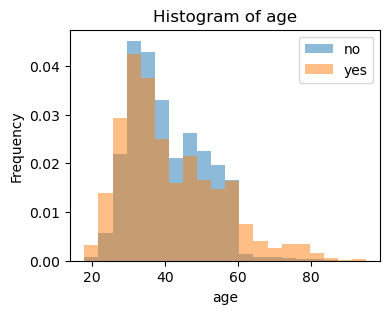

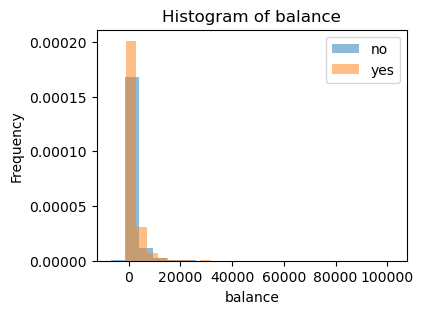

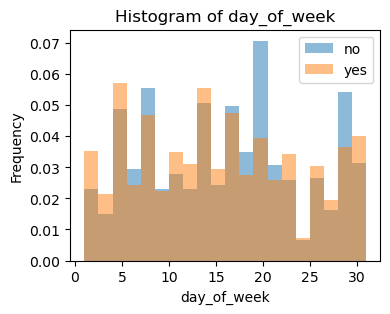

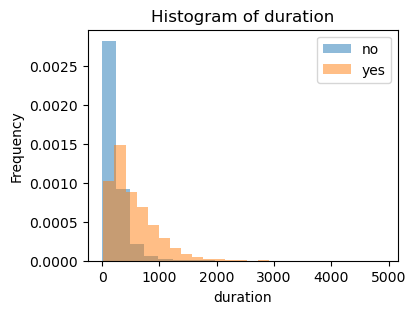

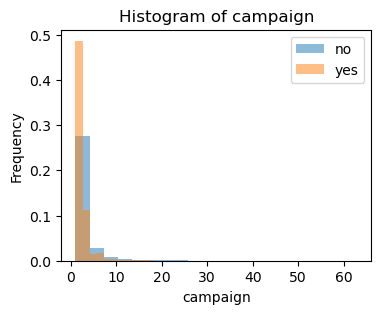

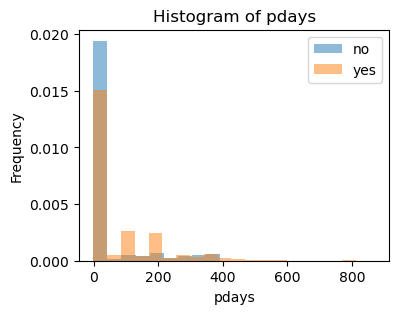

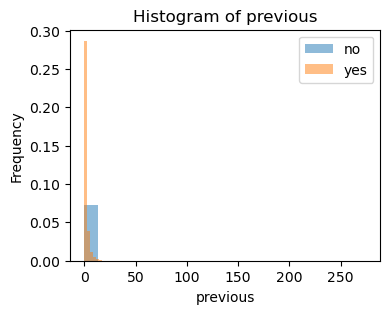

In [9]:
# Distribution of numerical columns
numeric_cols = eda_train_df.select_dtypes(include=['number']).columns.to_list()
for i in numeric_cols:
    feature = i
    plt.figure(figsize=(4, 3))
    plot = eda_train_df.groupby("subscribed")[feature].plot.hist(bins=20, alpha = 0.5, legend = True, density = True, title = "Histogram of " + feature)
    plt.xlabel(feature)
    plt.show()

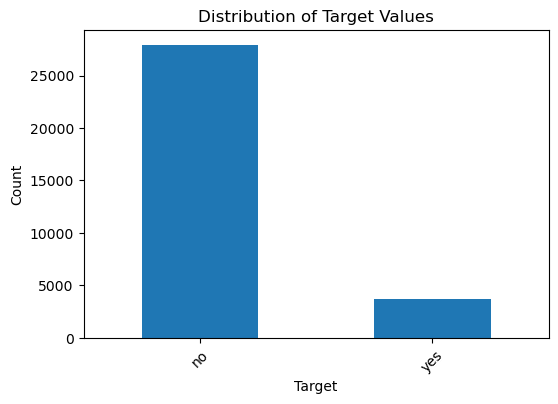

In [10]:
# target class imbalance
counts = eda_train_df["subscribed"].value_counts()
fig, ax = plt.subplots(figsize=(6, 4))
counts.plot(kind='bar', ax=ax)
ax.set_title('Distribution of Target Values')
ax.set_xlabel('Target')
ax.set_ylabel('Count')
plt.xticks(rotation=45)
plt.show()

In [11]:
# Distribution of NA values in all columns
alt.data_transformers.enable('vegafusion')

alt.Chart(
    eda_train_df.isna().reset_index().melt(
        id_vars='index'
    )
).mark_rect().encode(
    alt.X('index:O').axis(None),
    alt.Y('variable').title(None),
    alt.Color('value').title('NaN'),
    alt.Stroke('value')
).properties(
    width=eda_train_df.shape[0]
)

alt.Chart(...)

In [12]:
# Distribution of numerical columns
age_hist = alt.Chart(eda_train_df).mark_bar().encode(
    alt.X('age').bin(maxbins=30),
    y='count()'
)

balance_hist = alt.Chart(eda_train_df).mark_bar().encode(
    alt.X('balance:Q', bin=alt.Bin(maxbins=50, extent=[-2000, 10000])), #most values lie in this range
    y='count()'
)

duration_hist = alt.Chart(eda_train_df).mark_bar().encode(
    alt.X('duration', bin=alt.Bin(maxbins=30, extent=[0, 2000])), #most values lie in this range
    y='count()'
)

(age_hist | balance_hist) & duration_hist

alt.VConcatChart(...)

In [13]:
# Unique values in categorical columns
cat_cols = ["job", "marital", "education"]
for column in cat_cols:
    unique_values = list(eda_train_df[column].unique())
    print(f"{column}: {unique_values}")

job: ['entrepreneur', 'management', 'technician', 'blue-collar', 'housemaid', 'admin.', 'services', 'self-employed', 'retired', 'unemployed', 'student', nan]
marital: ['married', 'single', 'divorced']
education: ['tertiary', 'secondary', 'primary', nan]


# Preprocessing

In [14]:
# drop poutcome, contact - too many na values
bank_marketing_data = bank_marketing_data.drop(["poutcome", "contact"], axis = 1)
bank_marketing_data = bank_marketing_data.dropna()
bank_marketing_data

,age,job,marital,education,default,balance,housing,loan,day_of_week,month,duration,campaign,pdays,previous,subscribed
0,58,management,married,tertiary,no,2143,yes,no,5,may,261,1,-1,0,no
1,44,technician,single,secondary,no,29,yes,no,5,may,151,1,-1,0,no
2,33,entrepreneur,married,secondary,no,2,yes,yes,5,may,76,1,-1,0,no
5,35,management,married,tertiary,no,231,yes,no,5,may,139,1,-1,0,no
6,28,management,single,tertiary,no,447,yes,yes,5,may,217,1,-1,0,no
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45206,51,technician,married,tertiary,no,825,no,no,17,nov,977,3,-1,0,yes
45207,71,retired,divorced,primary,no,1729,no,no,17,nov,456,2,-1,0,yes
45208,72,retired,married,secondary,no,5715,no,no,17,nov,1127,5,184,3,yes
45209,57,blue-collar,married,secondary,no,668,no,no,17,nov,508,4,-1,0,no


In [15]:
# pre-process data (e.g., scale and split into train & test)
np.random.seed(522)
set_config(transform_output="pandas")

bank_marketing_train.to_csv("data/processed/bank_marketing_train.csv")
bank_marketing_test.to_csv("data/processed/bank_marketing_test.csv")

In [16]:
numeric_features = ['age', 'balance', 'duration', 'campaign', 'pdays', 'previous']
categorical_features = ['job', 'marital']
ordinal_features = ['education']
binary_features = ['default', 'housing', 'loan']
drop_features = ['day_of_week', 'month']
target = "subscribed"

In [17]:
X_train = bank_marketing_train.drop(columns=target)
y_train = bank_marketing_train[target]
X_test = bank_marketing_test.drop(columns=target)
y_test = bank_marketing_test[target]

In [18]:
numeric_transformer = StandardScaler()

categorical_transformer = OneHotEncoder(handle_unknown="ignore", sparse_output=False)

education_order = ['primary', 'secondary', 'tertiary']
ordinal_transformer = OrdinalEncoder(categories=[education_order], dtype=int)

binary_transformer = OneHotEncoder(drop = 'if_binary', dtype=int, handle_unknown = "ignore", sparse_output=False)

In [19]:
preprocessor = make_column_transformer(
    (numeric_transformer, numeric_features),
    (ordinal_transformer, ordinal_features),
    (binary_transformer, binary_features),  
    (categorical_transformer, categorical_features),
    ("drop", drop_features),  
)

preprocessor.fit(X_train)
preprocessed_X_train = preprocessor.transform(X_train)
preprocessed_X_test = preprocessor.transform(X_test)

preprocessed_X_train.to_csv("data/processed/preprocessed_X_train.csv")
preprocessed_X_test.to_csv("data/processed/preprocessed_X_test.csv")

preprocessed_X_train

,standardscaler__age,standardscaler__balance,standardscaler__duration,standardscaler__campaign,standardscaler__pdays,standardscaler__previous,ordinalencoder__education,onehotencoder-1__default_yes,onehotencoder-1__housing_yes,onehotencoder-1__loan_yes,...,onehotencoder-2__job_management,onehotencoder-2__job_retired,onehotencoder-2__job_self-employed,onehotencoder-2__job_services,onehotencoder-2__job_student,onehotencoder-2__job_technician,onehotencoder-2__job_unemployed,onehotencoder-2__marital_divorced,onehotencoder-2__marital_married,onehotencoder-2__marital_single
37264,-0.357800,-0.004922,-0.626299,1.059941,1.329205,1.782877,2,0,1,0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
41951,3.358115,0.548504,0.325015,-0.573060,1.429251,0.219604,2,0,0,0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
44550,-1.120039,-0.180799,0.773820,-0.573060,-0.411605,-0.301487,2,0,0,0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
461,-0.167240,-0.453492,0.010467,-0.246460,-0.411605,-0.301487,0,0,1,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
23300,-0.167240,-0.426357,-0.806588,0.406741,-0.411605,-0.301487,2,0,1,1,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3229,1.547798,0.679156,-0.706854,-0.573060,-0.411605,-0.301487,1,0,1,0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
10384,-0.262520,-0.283980,-0.526564,-0.573060,-0.411605,-0.301487,0,0,1,1,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
42552,1.738357,0.472458,-0.085431,-0.573060,1.659358,0.740695,2,0,0,0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
36352,-0.643639,-0.321166,-0.419158,-0.246460,3.240093,3.867241,1,0,1,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


# Model training

In [20]:
model_comparison = { "model_name": [], "mean_train_score": [], "mean_test_score": [] }

### K-Nearest Neighbors

In [21]:
# tune model (here, find k for k-Nearest Neighbors classification using 10 fold cv)
knn_pipe = make_pipeline(preprocessor, KNeighborsClassifier(n_jobs=-1))
parameter_grid = {
    "kneighborsclassifier__n_neighbors": np.arange(1, 20, 2),
}

cv = 10
knn_search = GridSearchCV(
    estimator=knn_pipe,
    param_grid=parameter_grid,
    cv=cv,
    scoring=make_scorer(fbeta_score, pos_label='yes', beta=5),
    n_jobs=-1,
    return_train_score=True,
)

bank_marketing_fit_knn = knn_search.fit(X_train, y_train)

In [22]:
best_model_scores_knn = pd.DataFrame(knn_search.cv_results_)[ [
                 "mean_test_score",
                 "mean_train_score",
                 "param_kneighborsclassifier__n_neighbors",
                 "rank_test_score",
] ].set_index("rank_test_score").sort_index().iloc[1, :]
model_comparison["model_name"].append("K-Nearest Neighbors")
model_comparison["mean_train_score"].append(best_model_scores_knn["mean_train_score"])
model_comparison["mean_test_score"].append(best_model_scores_knn["mean_test_score"])

In [23]:
accuracies_grid_knn = pd.DataFrame(bank_marketing_fit_knn.cv_results_)
accuracies_grid_knn = (
    accuracies_grid_knn[[
        "param_kneighborsclassifier__n_neighbors",
        "mean_test_score",
        "std_test_score"
    ]]
    .assign(
        sem_test_score=accuracies_grid_knn["std_test_score"] / cv**(1/2),
        sem_test_score_lower=lambda df: df["mean_test_score"] - (df["sem_test_score"]/2),
        sem_test_score_upper=lambda df: df["mean_test_score"] + (df["sem_test_score"]/2)
    )
    .rename(columns={"param_kneighborsclassifier__n_neighbors": "k"})
    .drop(columns=["std_test_score"])
)

accuracies_grid_knn.sort_values("mean_test_score", ascending=False)

,k,mean_test_score,sem_test_score,sem_test_score_lower,sem_test_score_upper
0,1,0.364398,0.005040,0.361878,0.366917
1,3,0.313996,0.004983,0.311505,0.316488
2,5,0.292493,0.006806,0.289090,0.295896
3,7,0.281991,0.006351,0.278815,0.285166
4,9,0.272214,0.007208,0.268610,0.275818
5,11,0.259206,0.008506,0.254953,0.263459
6,13,0.251543,0.005982,0.248551,0.254534
7,15,0.245912,0.006005,0.242909,0.248914
8,17,0.239354,0.007578,0.235565,0.243142
9,19,0.232171,0.006336,0.229002,0.235339


In [24]:
line_n_point_knn = alt.Chart(accuracies_grid_knn, width=600).mark_line(color="black").encode(
    x=alt.X("k", scale=alt.Scale(type='log'), title="k"),
    y=alt.Y("mean_test_score")
        .scale(zero=False) 
        .title("F2 score (beta = 5)")
)

line_n_point_knn + line_n_point_knn.mark_circle(color='black')

alt.LayerChart(...)

### SVM with Linear Kernel

In [25]:
svc_pipe = make_pipeline(preprocessor, SVC(class_weight={'no': 1, 'yes': 10}))
parameter_grid = {
    "svc__C": 10.0 ** np.arange(-3, 3, 1),
}

cv = 10
svc_search =GridSearchCV(
    estimator=svc_pipe,
    param_grid=parameter_grid,
    cv=cv,
    scoring=make_scorer(fbeta_score, pos_label='yes', beta=5),
    n_jobs=-1,
    return_train_score=True,
)

bank_marketing_fit_svc = svc_search.fit(X_train, y_train)

In [26]:
best_model_scores_svc = pd.DataFrame(svc_search.cv_results_)[ [
                 "mean_test_score",
                 "mean_train_score",
                 "param_svc__C",
                 "rank_test_score",
] ].set_index("rank_test_score").sort_index().iloc[1, :]
model_comparison["model_name"].append("SVC RBF")
model_comparison["mean_train_score"].append(best_model_scores_svc["mean_train_score"])
model_comparison["mean_test_score"].append(best_model_scores_svc["mean_test_score"])

In [27]:
accuracies_grid_svc = pd.DataFrame(bank_marketing_fit_svc.cv_results_)
accuracies_grid_svc = (
    accuracies_grid_svc[[
        "param_svc__C",
        "mean_test_score",
        "std_test_score"
    ]]
    .assign(
        sem_test_score=accuracies_grid_svc["std_test_score"] / cv**(1/2),
        sem_test_score_lower=lambda df: df["mean_test_score"] - (df["sem_test_score"]/2),
        sem_test_score_upper=lambda df: df["mean_test_score"] + (df["sem_test_score"]/2)
    )
    .rename(columns={"param_svc__C": "C"})
    .drop(columns=["std_test_score"])
)

accuracies_grid_svc.sort_values("mean_test_score", ascending=False)

,C,mean_test_score,sem_test_score,sem_test_score_lower,sem_test_score_upper
2,0.1,0.811541,0.004012,0.809535,0.813547
1,0.01,0.807548,0.003899,0.805599,0.809498
3,1.0,0.794402,0.006315,0.791244,0.797559
0,0.001,0.791390,0.004554,0.789113,0.793667
4,10.0,0.729584,0.007788,0.725690,0.733477
5,100.0,0.626582,0.006494,0.623336,0.629829


In [28]:
line_n_point_svc = alt.Chart(accuracies_grid_svc, width=600).mark_line(color="black").encode(
    x=alt.X("C", scale=alt.Scale(type='log'), title="C"),
    y=alt.Y("mean_test_score")
        .scale(zero=False) 
        .title("F2 score (beta = 5)")
)

line_n_point_svc + line_n_point_svc.mark_circle(color='black')

alt.LayerChart(...)

### Logistic Regression

In [29]:
# tune model (here, find C for logistic regression using 10 fold cv)
lr_pipe = make_pipeline(preprocessor, LogisticRegression(max_iter=500, class_weight={'no': 1, 'yes': 10}))

parameter_grid = {
    "logisticregression__C": 10.0 ** np.arange(-3, 5, 1),
}

cv = 10
lr_search = GridSearchCV(
    estimator=lr_pipe,
    param_grid=parameter_grid,
    cv=cv,
    scoring=make_scorer(fbeta_score, pos_label='yes', beta=5),
    n_jobs=-1,
    return_train_score=True,
)

bank_marketing_fit_lr = lr_search.fit(X_train, y_train)

In [30]:
best_model_scores_lr = pd.DataFrame(lr_search.cv_results_)[ [
                 "mean_test_score",
                 "mean_train_score",
                 "param_logisticregression__C",
                 "rank_test_score",
] ].set_index("rank_test_score").sort_index().iloc[1, :]
model_comparison["model_name"].append("Logistic Regression")
model_comparison["mean_train_score"].append(best_model_scores_lr["mean_train_score"])
model_comparison["mean_test_score"].append(best_model_scores_lr["mean_test_score"])

In [31]:
accuracies_grid_lr = pd.DataFrame(bank_marketing_fit_lr.cv_results_)
accuracies_grid_lr = (
    accuracies_grid_lr[[
        "param_logisticregression__C",
        "mean_test_score",
        "std_test_score"
    ]]
    .assign(
        sem_test_score=accuracies_grid_lr["std_test_score"] / cv**(1/2),
        sem_test_score_lower=lambda df: df["mean_test_score"] - (df["sem_test_score"]/2),
        sem_test_score_upper=lambda df: df["mean_test_score"] + (df["sem_test_score"]/2)
    )
    .rename(columns={"param_logisticregression__C": "C"})
    .drop(columns=["std_test_score"])
)

accuracies_grid_lr.sort_values("mean_test_score", ascending=False)

,C,mean_test_score,sem_test_score,sem_test_score_lower,sem_test_score_upper
1,0.01,0.781160,0.003526,0.779397,0.782923
2,0.1,0.780442,0.003202,0.778841,0.782043
4,10.0,0.779897,0.003337,0.778228,0.781566
6,1000.0,0.779897,0.003337,0.778229,0.781565
7,10000.0,0.779897,0.003337,0.778229,0.781565
5,100.0,0.779889,0.003339,0.778220,0.781559
3,1.0,0.779889,0.003334,0.778222,0.781556
0,0.001,0.779860,0.004883,0.777418,0.782301


In [32]:
line_n_point_lr = alt.Chart(accuracies_grid_lr, width=600).mark_line(color="black").encode(
    x=alt.X("C", scale=alt.Scale(type='log'), title="C"),
    y=alt.Y("mean_test_score")
        .scale(zero=False) 
        .title("F2 score (beta = 5)")
)

line_n_point_lr + line_n_point_lr.mark_circle(color='black')

alt.LayerChart(...)

### Random Forest

In [35]:
# tune model (here, find n_estimator and max_depth for random forest classifier using 10 fold cv)
rf_pipe = make_pipeline(preprocessor, RandomForestClassifier(n_jobs=-1, class_weight={'no': 1, 'yes': 10}))

parameter_grid = {
    "randomforestclassifier__n_estimators": [100, 200, 300, 400, 500],
    "randomforestclassifier__max_depth": [3, 5, 7, 15, 20, None],
}

cv = 10
rf_search = GridSearchCV(
    estimator=rf_pipe,
    param_grid=parameter_grid,
    cv=cv,
    scoring=make_scorer(fbeta_score, pos_label='yes', beta=5),
    n_jobs=-1,
    return_train_score=True,
)

bank_marketing_fit_rf = rf_search.fit(X_train, y_train)

In [36]:
best_model_scores_rf = pd.DataFrame(rf_search.cv_results_)[ [
                 "mean_test_score",
                 "mean_train_score",
                 "param_randomforestclassifier__n_estimators",
                 "param_randomforestclassifier__max_depth",
                 "rank_test_score",
] ].set_index("rank_test_score").sort_index().iloc[1, :]
model_comparison["model_name"].append("Random Forest")
model_comparison["mean_train_score"].append(best_model_scores_rf["mean_train_score"])
model_comparison["mean_test_score"].append(best_model_scores_rf["mean_test_score"])

In [37]:
accuracies_grid_rf = pd.DataFrame(bank_marketing_fit_rf.cv_results_)
accuracies_grid_rf = (
    accuracies_grid_rf[[
        "param_randomforestclassifier__n_estimators",
        "param_randomforestclassifier__max_depth",
        "mean_test_score",
        "std_test_score"
    ]]
    .assign(
        sem_test_score=accuracies_grid_rf["std_test_score"] / cv**(1/2),
        sem_test_score_lower=lambda df: df["mean_test_score"] - (df["sem_test_score"]/2),
        sem_test_score_upper=lambda df: df["mean_test_score"] + (df["sem_test_score"]/2)
    )
    .rename(columns={"param_randomforestclassifier__n_estimators": "n_estimators", "param_randomforestclassifier__max_depth": "max_depth"})
    .drop(columns=["std_test_score"])
)

accuracies_grid_rf.sort_values("mean_test_score", ascending=False)

,n_estimators,max_depth,mean_test_score,sem_test_score,sem_test_score_lower,sem_test_score_upper
4,500,3,0.831158,0.004737,0.828790,0.833527
1,200,3,0.830025,0.005108,0.827471,0.832579
2,300,3,0.828924,0.004742,0.826553,0.831295
0,100,3,0.828072,0.004540,0.825802,0.830342
3,400,3,0.827437,0.005224,0.824825,0.830049
6,200,5,0.825098,0.005628,0.822284,0.827912
5,100,5,0.823826,0.005316,0.821168,0.826484
7,300,5,0.823784,0.005273,0.821147,0.826420
8,400,5,0.823548,0.005109,0.820994,0.826103
9,500,5,0.822524,0.005659,0.819694,0.825354


# Prediction - FIXME please check if I did this correctly!

In [39]:
# Compute accuracy
y_pred = bank_marketing_fit_rf.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)

# Compute F2 score (beta = 5)
bank_marketing_preds = X_test.assign(
    predicted=bank_marketing_fit_rf.predict(X_test)
)
f2_beta_5_score = fbeta_score(
    y_test,
    bank_marketing_preds['predicted'],
    beta=5,
    pos_label='yes'
)

pd.DataFrame({'accuracy': [accuracy], 'F2 score (beta = 5)': [f2_beta_5_score]})

,accuracy,F2 score (beta = 5)
0,0.668622,0.822137


In [40]:
pd.crosstab(
    y_test,
    bank_marketing_preds['predicted'],
)

predicted,no,yes
subscribed,,
no,7299,4153
yes,141,1365


Talk about shortcomings of model and future directions

# References
- Moro,S., Rita,P., and Cortez,P.. (2012). Bank Marketing. UCI Machine Learning Repository. https://doi.org/10.24432/C5K306.
- Moro, S., Cortez, P., &amp; Rita, P. (2014). A data-driven approach to predict the success of bank telemarketing. Decision Support Systems, 62, 22–31. https://doi.org/10.1016/j.dss.2014.03.001 